In [1]:
# TODO drop Kherson point
# TODO investigate Unnamed
# TODO deleted_by

In [2]:
import pandas as pd
import seaborn as sns

from lib import create_markers_map, cast_color_v3
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt

In [3]:
SEED = 14

In [4]:
MODEL_COLUMNS = [
    "source",
    "foursquare_id",
    "lat",
    "lat",
    "category",
    "source",
    "altitude",
    "updated_at",
    "deleted_at",
    "created_at",
    "created_at",
    "created_at",
    "created_at",
    "category",
    
]

In [5]:
hotspots = pd.read_parquet("cleaned_data/hotspots.parquet").replace('nan', np.nan)
print(hotspots.info())
print(hotspots.nunique())


<class 'pandas.core.frame.DataFrame'>
Int64Index: 1400 entries, 0 to 1400
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   id                    1400 non-null   int64         
 1   foursquare_id         606 non-null    object        
 2   name                  922 non-null    object        
 3   address               1218 non-null   object        
 4   lat                   1400 non-null   float64       
 5   lng                   1400 non-null   float64       
 6   category              1266 non-null   category      
 7   source                1221 non-null   category      
 8   ssid                  1327 non-null   object        
 9   bssid                 1329 non-null   object        
 10  altitude              1190 non-null   float64       
 11  deleted_at            479 non-null    datetime64[ns]
 12  created_at            1400 non-null   datetime64[ns]
 13  updated_at        

In [6]:
active_hotspots = hotspots[hotspots["deleted_at"].isnull()]
# deleted_hotspots = hotspots[hotspots["deleted_at"].isnull() == False]
hotspots = active_hotspots
# print(hotspots.info())


## Histograms

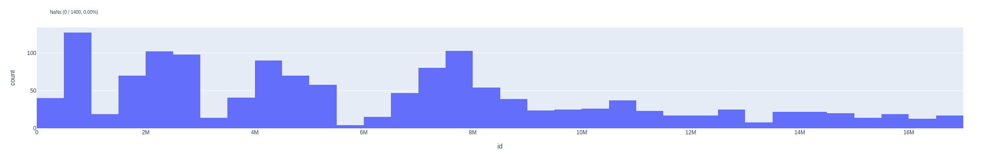

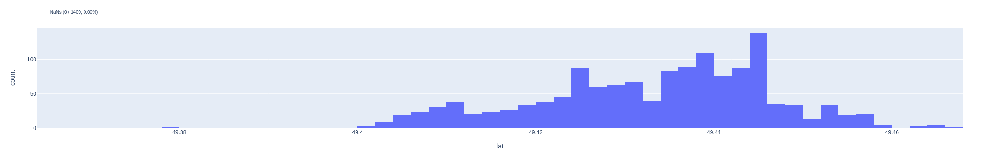

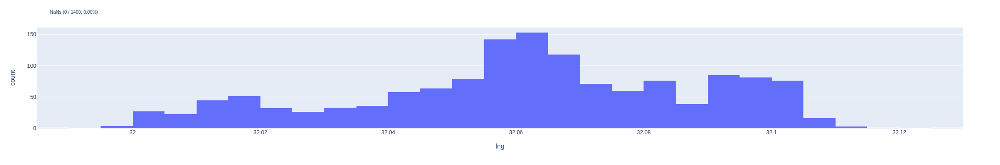

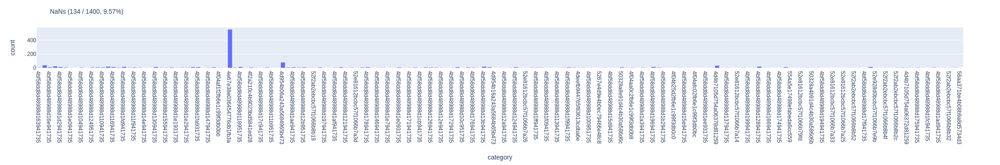

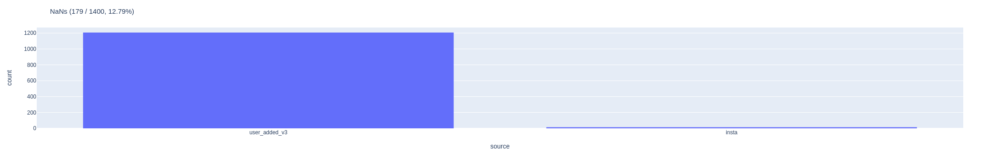

...

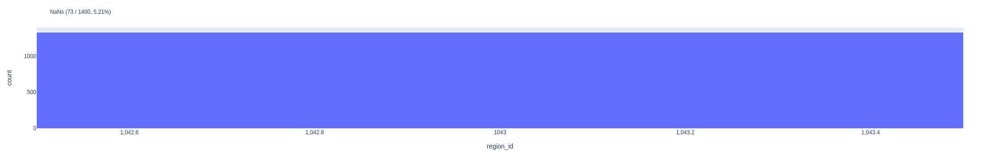

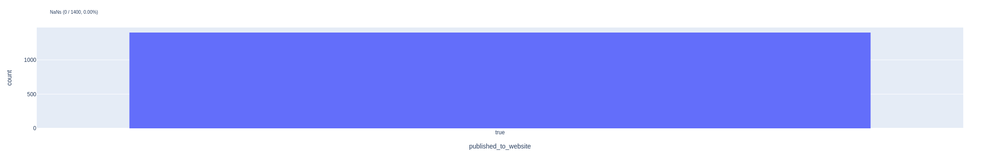

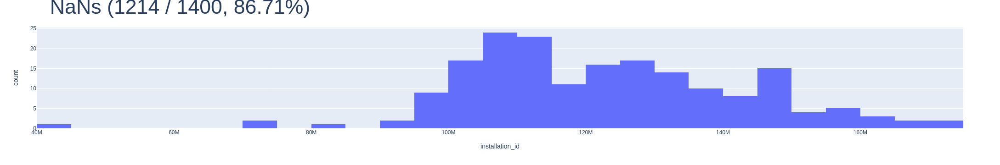

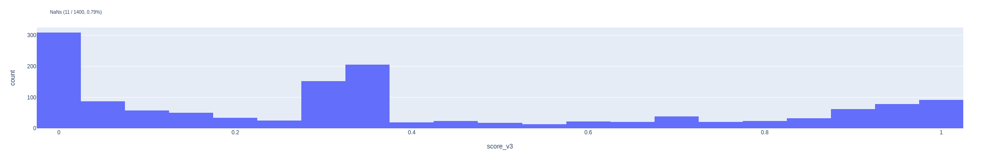

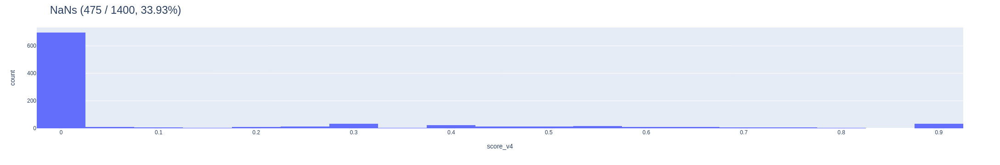

In [6]:
import plotly.express as px
import numpy as np
import matplotlib.pyplot as plt

# Loop through each column and create a histogram
for column in hotspots.select_dtypes(exclude = ["object"]).columns:
    fig = px.histogram(hotspots, x=column)
    
    series = hotspots[column]
    n_nans = series.isna().sum()
    pct_nans = n_nans / len(series) * 100
    
    fig.update_layout(
        title_text=f"NaNs ({n_nans} / {len(series)}, {pct_nans:.2f}%)",
        title_font=dict(size=10 + 40 * pct_nans / 100)
    )
    
    fig.show()

In [7]:
for col in hotspots.select_dtypes(include='object').columns:
    series = hotspots[col].apply(lambda x: np.nan if x == "nan" else x)
    nan_count = series.isna().sum()
    nan_percent = nan_count / len(series) * 100
    unique_count = series.nunique()
    max_reps = series.value_counts().max()
    mean_reps = series.value_counts().mean()
    min_reps = series.value_counts().min()

    print(f"Column {col}:")
    print(f"Number of NaNs: {nan_count} ({nan_percent:.2f}%)")
    print(f"Number of unique values: {unique_count}")
    print(f"Number of repetitions: Maximum - {max_reps}, Mean- {mean_reps:.2f}, Minimum - {min_reps}")
    print()

Column foursquare_id:
Number of NaNs: 794 (56.71%)
Number of unique values: 468
Number of repetitions: Maximum - 5, Mean- 1.29, Minimum - 1

Column name:
Number of NaNs: 478 (34.14%)
Number of unique values: 646
Number of repetitions: Maximum - 112, Mean- 1.43, Minimum - 1

Column address:
Number of NaNs: 182 (13.00%)
Number of unique values: 1009
Number of repetitions: Maximum - 15, Mean- 1.21, Minimum - 1

Column ssid:
Number of NaNs: 73 (5.21%)
Number of unique values: 1046
Number of repetitions: Maximum - 66, Mean- 1.27, Minimum - 1

Column bssid:
Number of NaNs: 71 (5.07%)
Number of unique values: 1250
Number of repetitions: Maximum - 6, Mean- 1.06, Minimum - 1

Column author_device_id:
Number of NaNs: 193 (13.79%)
Number of unique values: 915
Number of repetitions: Maximum - 40, Mean- 1.32, Minimum - 1

Column client_ip:
Number of NaNs: 335 (23.93%)
Number of unique values: 946
Number of repetitions: Maximum - 46, Mean- 1.13, Minimum - 1

Column google_place_id:
Number of NaNs: 1

## Scatter plots

In [16]:
from lib import cast_quality_v3
def plot_scatter(date_column, dataframe, y_callback, color_callback):
    """
    Creates a plotly scatter plot with date_column on the x axis, y_callback on the y axis, and
    colored dots according to color_callback.
    
    Args:
    date_column (str): The name of the column in the dataframe that contains dates.
    dataframe (pandas.DataFrame): The dataframe containing the data to plot.
    y_callback (function): A function that takes the dataframe as an argument and returns a pandas.Series
                           to use as the y values in the plot.
    color_callback (function): A function that takes the dataframe as an argument and returns a pandas.Series
                               to use for coloring the dots in the plot.
    
    Returns:
    fig (plotly.graph_objs._figure.Figure): The plotly figure object containing the scatter plot.
    """
    # Apply the y_callback function to the dataframe to get the y values for the plot.
    y_values = y_callback(dataframe)
    
    # Apply the color_callback function to the dataframe to get the color values for the plot.
    color_values = dataframe.apply(color_callback, axis = 1)
    
    # Create the plotly figure object with the scatter plot.
    fig = px.scatter(dataframe, x=date_column, y=y_values, color=color_values)
    
    return fig

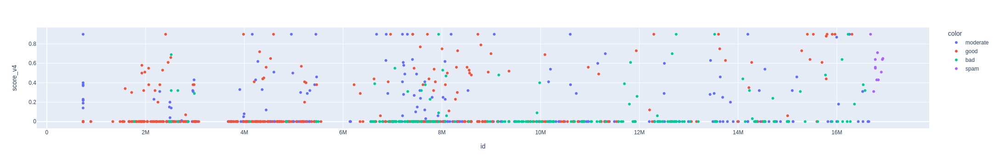

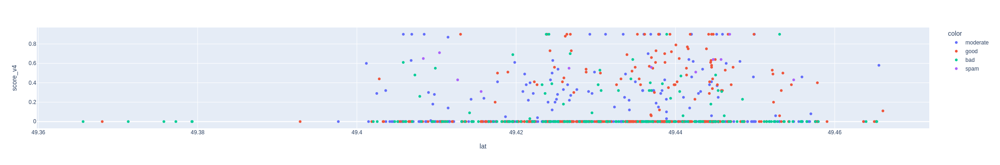

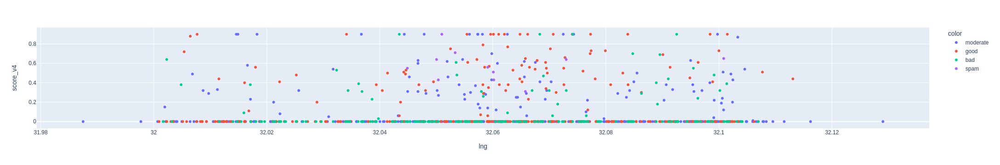

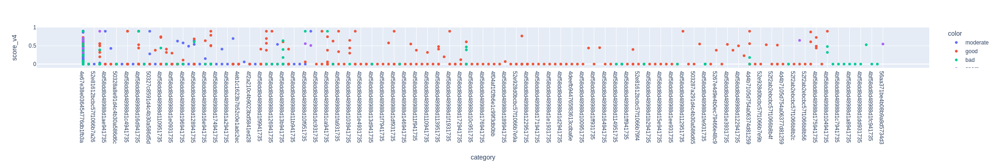

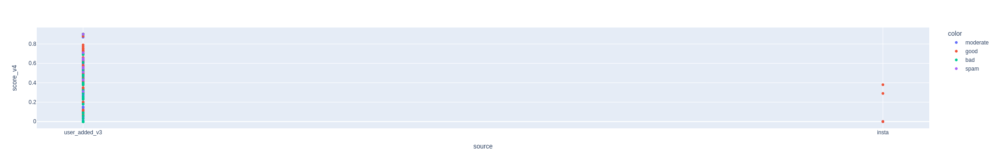

...

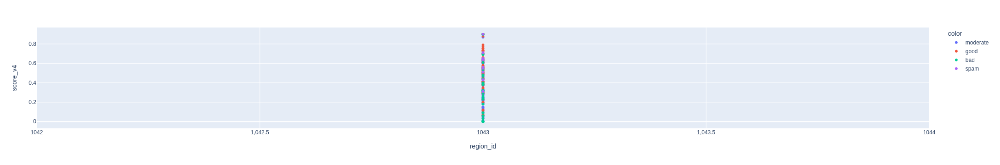

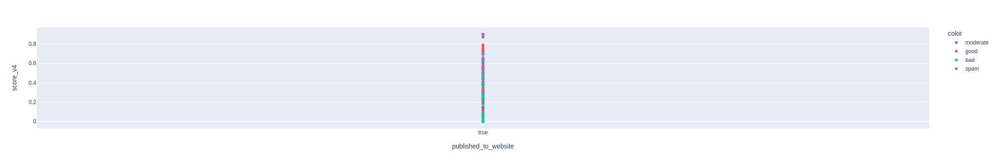

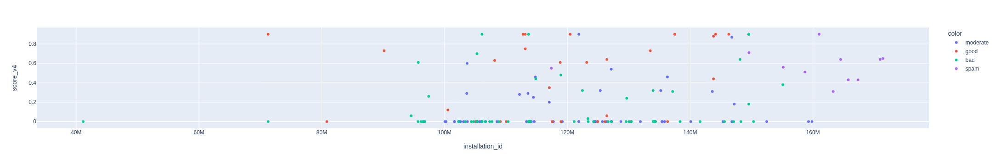

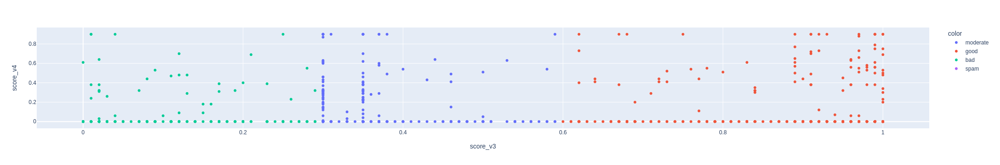

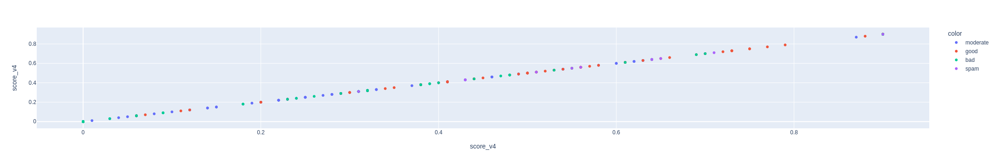

In [11]:

for column in active_hotspots.select_dtypes(exclude = ["object"]).columns:
    fig = plot_scatter(column, active_hotspots, lambda x: x["score_v4"], cast_quality_v3)
    fig.show()

In [ ]:

for column in active_hotspots.select_dtypes(exclude = ["object"]).columns:
    fig = plot_scatter(column, active_hotspots, lambda x: x["score_v4"], cast_quality_v3)
    fig.show()

## Name

In [40]:
hotspots["name"].value_counts().head(30)

Home WiFi                              112
Cherkasy                                14
Браво                                    5
Деликат                                  5
Fugu                                     5
1000+1 Ніч                               4
Дніпро Плаза / Dnipro Plaza              4
Тарас Бульба                             4
АТБ                                      4
Час поїсти                               4
~Родной дом~                             4
Домашний Wi-Fi                           4
Plazma-Classic                           4
Черкаський Національний Університет      4
Сушия / Sushiya                          4
Общежитие ЧПТ                            4
Cherkassy Bierstube                      3
Гагарина 83                              3
ЗОШ №34                                  3
ЧДТУ, корпус № 1                         3
ТРЦ "Любава"                             3
Фабрика кави                             3
MOYO                                     3
ЗОШ № 32   

In [25]:
from lib import cast_color_v4

In [26]:
map_obj = create_markers_map(hotspots[hotspots["name"] == "Home WiFi"], cast_color_v4)
map_obj

In [27]:
map_obj = create_markers_map(hotspots[hotspots["name"] == "Cherkasy"], cast_color_v4)
map_obj

## Date Analysis

In [10]:
hotspots.info()
# TODO deleted_by

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1400 entries, 0 to 1400
Data columns (total 37 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   id                    1400 non-null   int64         
 1   foursquare_id         606 non-null    object        
 2   name                  922 non-null    object        
 3   address               1218 non-null   object        
 4   lat                   1400 non-null   float64       
 5   lng                   1400 non-null   float64       
 6   category              1266 non-null   category      
 7   source                1221 non-null   category      
 8   ssid                  1327 non-null   object        
 9   bssid                 1329 non-null   object        
 10  altitude              1190 non-null   float64       
 11  deleted_at            479 non-null    datetime64[ns]
 12  created_at            1400 non-null   datetime64[ns]
 13  updated_at        

In [11]:
date_columns = [
    "updated_at",
    "deleted_at",
    "created_at",
    "last_connected_at",
    "last_seen_at"
]

active_hotspots = hotspots[date_columns + ["score_v3", "score_v4"]].copy()

In [30]:
hotspots["deleted_by"].value_counts()

5.0     231
1.0      78
10.0     55
3.0      50
6.0      23
7.0      14
8.0      13
12.0      7
0.0       7
11.0      1
Name: deleted_by, dtype: int64

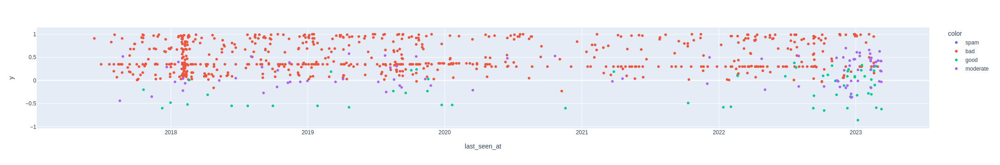

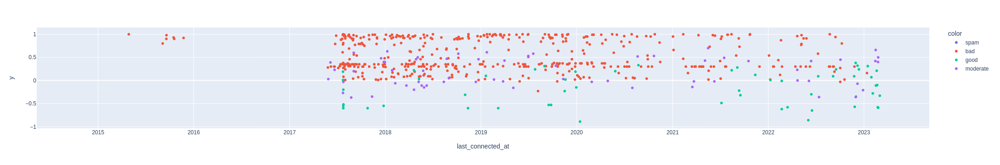

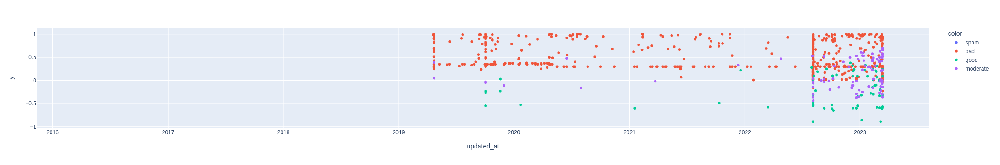

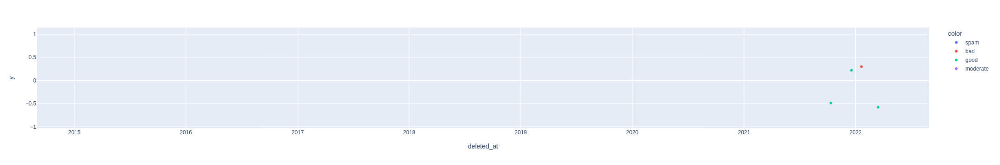

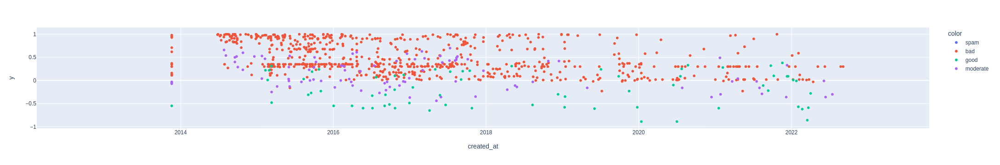

In [22]:
plot_scatter("last_seen_at", hotspots, lambda x: x["score_v3"] - x["score_v4"], cast_quality_v4).show()
plot_scatter("last_connected_at", hotspots, lambda x: x["score_v3"] - x["score_v4"], cast_quality_v4).show()
plot_scatter("updated_at", hotspots, lambda x: x["score_v3"] - x["score_v4"], cast_quality_v4).show()
plot_scatter("deleted_at", hotspots, lambda x: x["score_v3"] - x["score_v4"], cast_quality_v4).show()
plot_scatter("created_at", hotspots, lambda x: x["score_v3"] - x["score_v4"], cast_quality_v4).show()


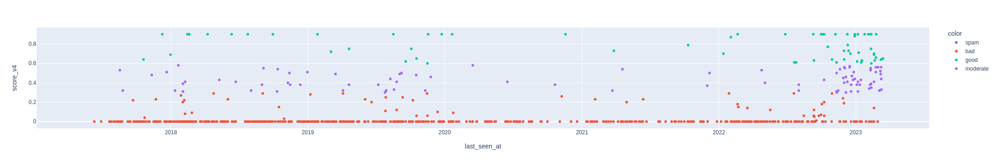

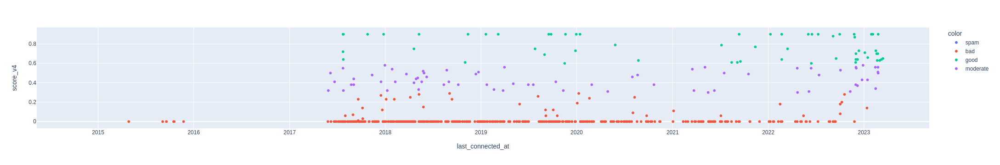

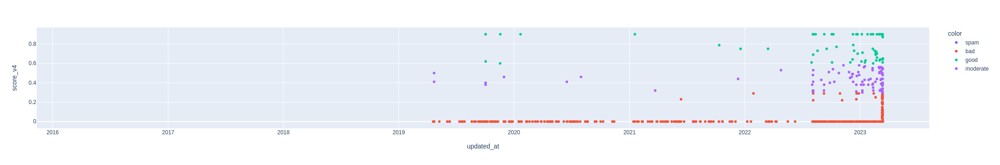

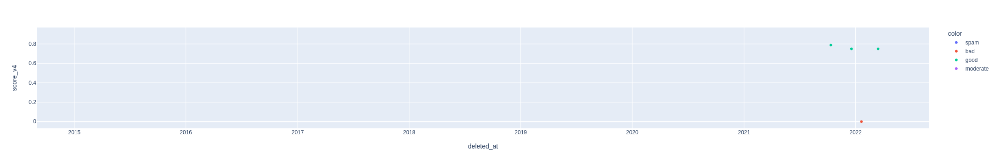

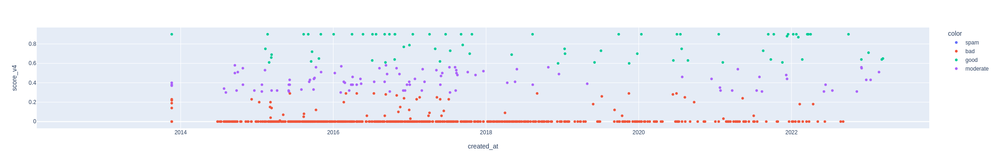

In [23]:
plot_scatter("last_seen_at", hotspots, lambda x: x["score_v4"], cast_quality_v4).show()
plot_scatter("last_connected_at", hotspots, lambda x: x["score_v4"], cast_quality_v4).show()
plot_scatter("updated_at", hotspots, lambda x: x["score_v4"], cast_quality_v4).show()
plot_scatter("deleted_at", hotspots, lambda x: x["score_v4"], cast_quality_v4).show()
plot_scatter("created_at", hotspots, lambda x: x["score_v4"], cast_quality_v4).show()

## IDs Comparison

In [20]:
IDS_COLUMNS = ["author_device_id", "installation_id", "client_ip", "owner_id", "ssid", "bssid", "foursquare_id", "zone_id"]

print(hotspots[IDS_COLUMNS].nunique(dropna = False))
print()
print(hotspots[IDS_COLUMNS].info())

author_device_id     916
installation_id      170
client_ip            947
owner_id             417
ssid                1047
bssid               1251
foursquare_id        469
zone_id                8
dtype: int64

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1400 entries, 0 to 1400
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   author_device_id  1207 non-null   object 
 1   installation_id   186 non-null    float64
 2   client_ip         1065 non-null   object 
 3   owner_id          699 non-null    float64
 4   ssid              1327 non-null   object 
 5   bssid             1329 non-null   object 
 6   foursquare_id     606 non-null    object 
 7   zone_id           1400 non-null   float64
dtypes: float64(3), object(5)
memory usage: 98.4+ KB
None


In [21]:
import pandas as pd
import numpy as np
from typing import Callable

from scipy.stats import chi2_contingency

def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x, y)
    chi2 = chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r, k = confusion_matrix.shape
    phi2corr = max(0, phi2 - ((k-1)*(r-1))/(n-1))
    rcorr = r - ((r-1)**2)/(n-1)
    kcorr = k - ((k-1)**2)/(n-1)
    return np.sqrt(phi2corr / min((kcorr-1), (rcorr-1)))


def pairwise_correlations(df: pd.DataFrame, corr_callback: Callable) -> pd.DataFrame:
    """
    Calculate pairwise correlations between all pairs of features in a pandas DataFrame using a correlation callback function.
    
    Args:
        df (pd.DataFrame): Input dataframe with categorical features.
        corr_callback (Callable): A correlation callback function that takes two categorical series as input and returns a correlation value.
    
    Returns:
        pd.DataFrame: A new dataframe with a square matrix of pairwise correlations between all pairs of features in the input dataframe.
    """
    n_features = df.shape[1]
    corr_matrix = pd.DataFrame(np.zeros((n_features, n_features)), columns=df.columns, index=df.columns)

    for i in range(n_features):
        for j in range(i+1, n_features):
            corr = corr_callback(df.iloc[:, i], df.iloc[:, j])
            corr_matrix.iloc[i, j] = corr
            corr_matrix.iloc[j, i] = corr

    return corr_matrix

In [23]:
pairwise_correlations(hotspots[IDS_COLUMNS], cramers_v)

,author_device_id,installation_id,client_ip,owner_id,ssid,bssid,foursquare_id,zone_id
author_device_id,0.000000,1.000000,0.461947,0.943562,0.420107,0.501100,0.262758,0.219643
installation_id,1.000000,0.000000,0.960769,0.964486,0.499534,0.958140,0.565445,0.000000
client_ip,0.461947,0.960769,0.000000,0.513843,0.780768,0.768137,0.491773,0.276762
owner_id,0.943562,0.964486,0.513843,0.000000,0.466772,0.632545,0.440449,0.232494
ssid,0.420107,0.499534,0.780768,0.466772,0.000000,0.865150,0.516831,0.000000
bssid,0.501100,0.958140,0.768137,0.632545,0.865150,0.000000,0.716624,0.243296
foursquare_id,0.262758,0.565445,0.491773,0.440449,0.516831,0.716624,0.000000,0.477025
zone_id,0.219643,0.000000,0.276762,0.232494,0.000000,0.243296,0.477025,0.000000


In [72]:
hotspots["installation_id"].value_counts(dropna = False).sort_values().tail(20)

155150772.0       1
117393993.0       1
165745251.0       1
149570908.0       1
161006355.0       1
106614122.0       2
114590007.0       2
71265134.0        2
143792042.0       2
105276295.0       2
96630122.0        2
113139305.0       2
108157274.0       2
130358208.0       2
109094574.0       2
127185791.0       2
105114351.0       2
126431648.0       3
149541894.0       4
NaN            1214
Name: installation_id, dtype: int64

In [71]:
hotspots["client_ip"].value_counts(dropna = False).sort_values().tail(20)

193.254.196.36       2
78.137.31.96         2
46.201.224.233       2
109.122.62.130       2
77.121.217.224       3
109.122.30.249       3
212.82.217.146       3
193.108.251.187      3
109.227.85.195       3
193.108.249.139      3
78.137.25.80         4
195.95.232.162       4
37.115.117.153       4
212.82.217.186       4
195.95.232.146       5
78.137.5.113         5
78.137.2.108         8
193.108.248.23      15
193.0.240.44        46
nan                335
Name: client_ip, dtype: int64

In [73]:

hotspots["author_device_id"].value_counts(dropna = False).sort_values().tail(20)

37502332-A0B6-4D10-858A-38752E9AF7F5      4
9A2F2692-AA9E-4CAF-9FF1-D1590BE82167      4
d8c06f7e4d764e14                          4
C300DA90-4BE6-4470-BFA7-8AEBB6095B59      4
DCE6406B-8385-40C4-8E95-82EB8CA2F507      5
68A51D44-82D9-44A3-9F61-806B512FA8D3      5
b848e3aa46f8af6b                          5
4D85EDBB-ED40-4790-990C-37EEC5F32829      5
31a906eb8314ebaa                          5
84ABE8F4-A12C-40FE-8A2B-E1D1DCA015CD      5
966944D6-1AA5-4282-A89F-A5FF847EB3B4      6
5ee813aa8c9f8a94                          6
56193d92f8bcc8d9                          6
c526c2191a3c2750                          8
8c97f18280ea855d                         10
7472BD7F-DA0A-45D5-A97D-5764A6FAE1D8     11
c9eb74a215d9e87a                         13
ce856526c729e2bc                         20
3d38e608342a27c0                         40
nan                                     193
Name: author_device_id, dtype: int64

In [74]:
hotspots["owner_id"].value_counts(dropna = False).sort_values().tail(20)

5531467.0       4
14538936.0      5
8192587.0       5
2689482.0       5
7823067.0       5
1208135.0       5
3236141.0       5
3596688.0       6
5509082.0       6
1082165.0       6
4416422.0       6
2572071.0       7
2018639.0       8
2520459.0      10
1310856.0      11
878093.0       12
1989024.0      13
10672957.0     28
1433612.0      40
NaN           701
Name: owner_id, dtype: int64

In [84]:
hotspots.groupby("owner_id")["author_device_id"].nunique(dropna = False).sort_values().describe()

count    416.000000
mean       1.110577
std        0.419160
min        1.000000
25%        1.000000
50%        1.000000
75%        1.000000
max        5.000000
Name: author_device_id, dtype: float64

In [83]:
hotspots.groupby("author_device_id")["owner_id"].nunique(dropna = False).sort_values().describe()

count    916.000000
mean       1.008734
std        0.093096
min        1.000000
25%        1.000000
50%        1.000000
75%        1.000000
max        2.000000
Name: owner_id, dtype: float64

In [106]:
hotspots["foursquare_id"].value_counts().sort_values()

4f75b520e4b0f1780a742279      1
516e9873e4b07beaa363f182      1
511a6f4fe4b0918fd7b5ed8f      1
51ecc6ad498e9861e2b83ed2      1
5278be22498e074d8386336d      1
                           ... 
4f5ba7b9e4b05cd769884caa      4
4dcc0bd4fa76d745f06294cf      5
4ffad0cfe4b0903669c6107c      5
4e6f8fdbd4c06eaf9c3d125c      5
nan                         794
Name: foursquare_id, Length: 469, dtype: int64

## User Activity

In [6]:
def zone_count_scatter_plot(user_column, zone_column, data = hotspots):

    plot_df = data[data[user_column] != "nan"].groupby(user_column).agg(
        nunique_zones=pd.NamedAgg(column=zone_column, aggfunc="nunique"),
        hotspots_created=pd.NamedAgg(column="id", aggfunc="count"),
    ).reset_index().groupby(["nunique_zones", "hotspots_created"]).count().reset_index().rename(columns = {user_column: "user_count"})
    
    
    fig = px.scatter(plot_df, x="hotspots_created", y="nunique_zones", color="user_count")
    print(f"Zone id is {zone_column}")
    print(f"User id is {user_column}")
    fig.show()



In [7]:
data = hotspots.copy() #[hotspots["score_v4"] < 0.5]

Zone id is foursquare_id
User id is author_device_id


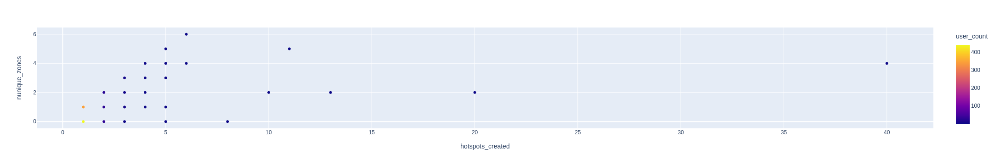

In [8]:
user_column = "author_device_id"
zone_column = "foursquare_id"
zone_count_scatter_plot(user_column, zone_column, data = data)

Zone id is zone_id
User id is author_device_id


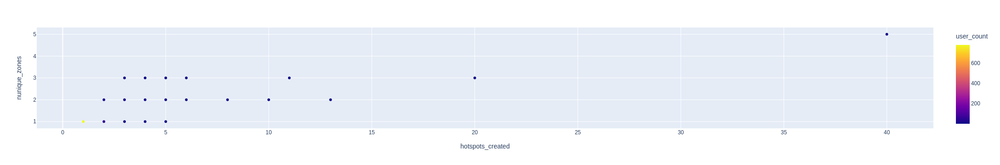

In [9]:

groupby_column = "author_device_id"
zone_column = "zone_id"
zone_count_scatter_plot(groupby_column, zone_column, data = data)

Zone id is zone_id
User id is installation_id


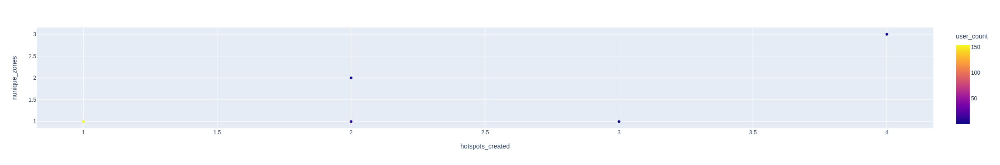

In [10]:

user_column = "installation_id"
zone_column = "zone_id"
zone_count_scatter_plot(user_column, zone_column, data = data)

### Quality

In [11]:
from lib import cast_quality

In [12]:

index_column = "author_device_id"
flat_columns = "quality"
df = hotspots.loc[hotspots[index_column] != "nan", [index_column, "id"]].copy()
df["quality"] = hotspots["score_v4"].copy().apply(cast_quality)

pivot = pd.pivot_table(df, index=index_column, columns=flat_columns, aggfunc='count')["id"]
total_count = pivot.sum(axis=1)
pivot = round(pivot.div(pivot.sum(axis=1), axis=0) * 100, 2)
pivot = pivot.dropna(how = "all")
pivot["total_count"] = total_count
user_chart = pivot.sort_values(by="total_count", ascending = False)[["good", "moderate", "bad", "spam", "total_count"]]
user_chart.head(19)

quality,good,moderate,bad,spam,total_count
author_device_id,,,,,
3d38e608342a27c0,5.0,5.00,60.00,30.00,40.0
ce856526c729e2bc,15.0,15.00,60.00,10.00,20.0
c9eb74a215d9e87a,NaN,NaN,61.54,38.46,13.0
7472BD7F-DA0A-45D5-A97D-5764A6FAE1D8,NaN,NaN,18.18,81.82,11.0
8c97f18280ea855d,NaN,10.00,60.00,30.00,10.0
c526c2191a3c2750,12.5,NaN,75.00,12.50,8.0
56193d92f8bcc8d9,NaN,NaN,100.00,NaN,6.0
966944D6-1AA5-4282-A89F-A5FF847EB3B4,NaN,16.67,66.67,16.67,6.0
5ee813aa8c9f8a94,NaN,NaN,66.67,33.33,6.0


In [13]:
import folium

## Category

In [77]:
category_value_counts = hotspots["category"].value_counts()#.sort_values().tail(40) #.index.to_list()
category_value_counts.sort_values().tail(20)

4bf58dd8d48988d198941735      8
5032891291d4c4b30a586d68      9
4bf58dd8d48988d1fa931735      9
4bf58dd8d48988d124941735      9
4bf58dd8d48988d109941735     10
4bf58dd8d48988d116941735     11
4bf58dd8d48988d130941735     11
4bf58dd8d48988d1d2941735     11
4bf58dd8d48988d196941735     12
4bf58dd8d48988d118951735     12
4d4b7105d754a06374d81259     12
4bf58dd8d48988d1fd941735     14
4bf58dd8d48988d13b941735     16
4bf58dd8d48988d1c4941735     17
4bf58dd8d48988d128941735     17
4bf58dd8d48988d1ca941735     21
4d4b7105d754a06378d81259     30
4bf58dd8d48988d16d941735     36
4d954b06a243a5684965b473     77
4e67e38e036454776db1fb3a    551
Name: category, dtype: int64

In [ ]:
"4e67e38e036454776db1fb3a" -> "home"
"4d954b06a243a5684965b473" -> "NaN"
"4bf58dd8d48988d16d941735" -> "cafe"
"4d4b7105d754a06378d81259" -> "services"
"4bf58dd8d48988d1ca941735" -> "pizza"
"4bf58dd8d48988d128941735" -> "coffee"

"4bf58dd8d48988d13b941735" -> "school"

In [81]:
from typing import List, Tuple
import folium
from geopy.geocoders import Nominatim
import pandas as pd

def create_cover_map(df: pd.DataFrame, radius: float, cast_color) -> folium.Map:
    """Creates a Folium map with markers for each row in the DataFrame."""
    # Define the map's center coordinates
    center_lat = df['lat'].mean()
    center_lng = df['lng'].mean()

    # Create the Folium map
    map_obj = folium.Map(location=[center_lat, center_lng], zoom_start=12)

    def add_marker(row: pd.Series) -> None:
        """Adds a marker to the map for a given row in the DataFrame."""
        popup_html = f"<b>name: {row['name']}</b>"
        display_columns = ["address", "connections_count", "score_v3", "score_v4", "category", "name"]
        for column in display_columns:
            popup_html += f"<br>{column}: {row[column]}"

        icon_color = cast_color(row)
        icon = folium.Icon(color=icon_color, icon='')

        folium.Marker(
            location=[row['lat'], row['lng']],
            popup=popup_html,
            icon=icon,
        ).add_to(map_obj)

    # Apply the add_marker function to each row of the DataFrame using the apply method
    df.apply(add_marker, axis=1)

    return map_obj

# "4e67e38e036454776db1fb3a" -> "home"
# "4d954b06a243a5684965b473" -> "NaN" home ??
# "4bf58dd8d48988d16d941735" -> "cafe"
# "4d4b7105d754a06378d81259" -> "services"
# "4bf58dd8d48988d1ca941735" -> "pizza"
# "4bf58dd8d48988d128941735" -> "coffee"

# "4bf58dd8d48988d13b941735" -> "school"
# "4bf58dd8d48988d1fd941735" -> "Shopping Mall"



data = hotspots #[hotspots["category"] == "4bf58dd8d48988d1a2941735"]

map_obj = create_cover_map(
    data, 50,
    cast_color_v3
)
map_obj


## Scores

In [14]:
from lib import cast_quality
hotspots["quality"] = hotspots["score_v3"].apply(cast_quality)

In [17]:
index_column = "category"
flat_columns = "quality"
df = hotspots[[index_column, flat_columns, "id"]]

pivot = pd.pivot_table(df, index=index_column, columns=flat_columns, aggfunc='count')["id"]
total_count = pivot.sum(axis=1)
pivot = round(pivot.div(pivot.sum(axis=1), axis=0) * 100, 2)
pivot = pivot.dropna(how = "all")
pivot["total_count"] = total_count
pivot[pivot["total_count"] > 10].sort_values(by="good")

quality,bad,good,moderate,spam,total_count
category,,,,,
4bf58dd8d48988d130941735,54.55,0.00,18.18,27.27,11
4bf58dd8d48988d196941735,58.33,0.00,8.33,33.33,12
4bf58dd8d48988d1d2941735,18.18,0.00,0.00,81.82,11
4bf58dd8d48988d1fd941735,50.00,0.00,0.00,50.00,14
4d954b06a243a5684965b473,64.94,1.30,7.79,25.97,77
4e67e38e036454776db1fb3a,61.89,5.08,7.08,25.95,551
4d4b7105d754a06378d81259,76.67,6.67,6.67,10.00,30
4bf58dd8d48988d118951735,66.67,8.33,0.00,25.00,12
4bf58dd8d48988d16d941735,44.44,8.33,5.56,41.67,36


In [18]:
hotspots["quality"] = hotspots["score_v3"].apply(cast_quality)

index_column = "author_device_id"
flat_columns = "quality"
df = hotspots[[index_column, flat_columns, "id"]]

pivot = pd.pivot_table(df, index=index_column, columns=flat_columns, aggfunc='count')["id"]
total_count = pivot.sum(axis=1)
pivot = round(pivot.div(pivot.sum(axis=1), axis=0) * 100, 2)
pivot = pivot.dropna(how = "all")
pivot["total_count"] = total_count
pivot.sort_values(by="total_count").tail(20)#[pivot["total_count"] > 10].sort_values(by="good")

quality,bad,good,moderate,spam,total_count
author_device_id,,,,,
5587923ab7097df9,25.00,75.00,NaN,NaN,4.0
37502332-A0B6-4D10-858A-38752E9AF7F5,NaN,50.00,50.00,NaN,4.0
6C967A01-4D99-486C-ABC8-3937BB786CB0,50.00,25.00,25.00,NaN,4.0
078D867D-26B7-413D-9ABA-FFE2FAE801F7,50.00,25.00,25.00,NaN,4.0
9A2F2692-AA9E-4CAF-9FF1-D1590BE82167,100.00,NaN,NaN,NaN,4.0
4D85EDBB-ED40-4790-990C-37EEC5F32829,40.00,60.00,NaN,NaN,5.0
68A51D44-82D9-44A3-9F61-806B512FA8D3,20.00,40.00,40.00,NaN,5.0
DCE6406B-8385-40C4-8E95-82EB8CA2F507,60.00,20.00,20.00,NaN,5.0
84ABE8F4-A12C-40FE-8A2B-E1D1DCA015CD,20.00,60.00,20.00,NaN,5.0


In [16]:
hotspots["quality"] = hotspots["score_v4"].apply(cast_quality)
index_column = "author_device_id"
flat_columns = "quality"
df = hotspots[[index_column, flat_columns, "id"]]

pivot = pd.pivot_table(df, index=index_column, columns=flat_columns, aggfunc='count')["id"]
total_count = pivot.sum(axis=1)
pivot = round(pivot.div(pivot.sum(axis=1), axis=0) * 100, 2)
pivot = pivot.dropna(how = "all")
pivot["total_count"] = total_count
pivot.sort_values(by="total_count").tail(20)#[pivot["total_count"] > 10].sort_values(by="good")

quality,bad,good,moderate,spam,total_count
author_device_id,,,,,
5587923ab7097df9,25.00,NaN,25.00,50.00,4.0
37502332-A0B6-4D10-858A-38752E9AF7F5,50.00,NaN,NaN,50.00,4.0
6C967A01-4D99-486C-ABC8-3937BB786CB0,50.00,25.0,NaN,25.00,4.0
078D867D-26B7-413D-9ABA-FFE2FAE801F7,25.00,75.0,NaN,NaN,4.0
9A2F2692-AA9E-4CAF-9FF1-D1590BE82167,NaN,NaN,NaN,100.00,4.0
4D85EDBB-ED40-4790-990C-37EEC5F32829,40.00,NaN,40.00,20.00,5.0
68A51D44-82D9-44A3-9F61-806B512FA8D3,80.00,NaN,NaN,20.00,5.0
DCE6406B-8385-40C4-8E95-82EB8CA2F507,60.00,NaN,NaN,40.00,5.0
84ABE8F4-A12C-40FE-8A2B-E1D1DCA015CD,80.00,NaN,NaN,20.00,5.0


### Top Scores

In [42]:
data = hotspots[["score_v4", "score_v3", "name", "address", "connections_count", "lng", "lat"]].copy().sort_values(by = "score_v4", ascending = False)

data

,score_v4,score_v3,name,address,connections_count,lng,lat
928,0.9,0.75,VANO,Шевченко 275,167.0,32.074050,49.436140
1227,0.9,0.99,Львівська майстерня шоколаду,"вул. Б. Вишневецького, 32",25.0,32.059601,49.444748
613,0.9,0.67,Управління Пенсійного фонду України в м.Черкасах,"вул. Героїв Сталінграду, 10",0.0,32.101491,49.435224
1352,0.9,1.00,Sport Готель,"Проспект Хіміків, 10",NaN,32.034115,49.413017
1149,0.9,0.37,NaN,"Памятник в честь столетия футбола, Черкаси, Че...",6.0,32.058155,49.436901
...,...,...,...,...,...,...,...
1353,NaN,0.05,Home WiFi,"вулиця Гоголя, 578/19, Черкаси, Черкаська обла...",1.0,32.100385,49.416942
1357,NaN,0.01,Home WiFi,"вулиця Гагаріна, 39, Черкаси, Черкаська област...",NaN,32.074750,49.442994
1368,NaN,0.00,Home WiFi,"провулок Тодося Осьмачки, 12, Черкаси, Черкась...",NaN,32.051896,49.453192
1378,NaN,0.01,Home WiFi,"вулиця Симиренківська, 2/2, Черкаси, Черкаська...",NaN,32.098471,49.415560


In [59]:
from lib import create_markers_map_colored

def create_color_column(score):
    if score >= 0.9: return "green"
    if score >= 0.8: return "blue"
    if score >= 0.7: return "lightblue"
    if score >= 0.6: return "orange"
    if score >= 0.5: return "red"

    return "black"
top = data[data["score_v4"] > 0.4].copy()
map_obj = create_markers_map_colored(top, top["score_v4"].apply(create_color_column))
map_obj

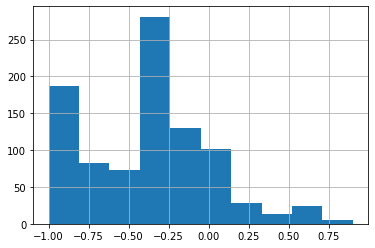

In [54]:


top["improvement"].hist()

In [55]:
top

,score_v4,score_v3,name,address,connections_count,lng,lat,improvement
928,0.9,0.75,VANO,Шевченко 275,167.0,32.074050,49.436140,0.15
1227,0.9,0.99,Львівська майстерня шоколаду,"вул. Б. Вишневецького, 32",25.0,32.059601,49.444748,-0.09
613,0.9,0.67,Управління Пенсійного фонду України в м.Черкасах,"вул. Героїв Сталінграду, 10",0.0,32.101491,49.435224,0.23
1352,0.9,1.00,Sport Готель,"Проспект Хіміків, 10",NaN,32.034115,49.413017,-0.10
1149,0.9,0.37,NaN,"Памятник в честь столетия футбола, Черкаси, Че...",6.0,32.058155,49.436901,0.53
...,...,...,...,...,...,...,...,...
1353,NaN,0.05,Home WiFi,"вулиця Гоголя, 578/19, Черкаси, Черкаська обла...",1.0,32.100385,49.416942,NaN
1357,NaN,0.01,Home WiFi,"вулиця Гагаріна, 39, Черкаси, Черкаська област...",NaN,32.074750,49.442994,NaN
1368,NaN,0.00,Home WiFi,"провулок Тодося Осьмачки, 12, Черкаси, Черкась...",NaN,32.051896,49.453192,NaN
1378,NaN,0.01,Home WiFi,"вулиця Симиренківська, 2/2, Черкаси, Черкаська...",NaN,32.098471,49.415560,NaN


In [58]:
from lib import create_markers_map_colored

def calc_imp(v3, v4):

    if v4 != v4: return np.nan
    if v4 == 0: return np.nan

    if v3 != v3: v3 = 0
    return v4 - v3
def calc_imp_row(row):

    return calc_imp(row["score_v3"], row["score_v4"])

def create_color_column(score):
    if score >= 0.5: return "green"
    if score >= 0.0: return "blue"
    if score >= -0.5: return "orange"

    return "black"

top = data.copy()
top["improvement"] = top.apply(calc_imp_row, axis = 1)

map_obj = create_markers_map_colored(top, top["improvement"].apply(create_color_column))
map_obj

In [49]:
np.nan > 2

False